------
<h1>
    <center>
        Sentinel-2A Image Preprocessing <b><br>
    </center>
</h1>

------


## Imports of Required Packages and Setup

### Import Python packages

In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from skimage import exposure
import rasterio as rio
from rasterio.plot import reshape_as_image

from osgeo import gdal, gdal_array
import cv2
from natsort import natsorted
from rasterio.windows import Window, transform
from tqdm import tqdm
from pathlib import Path


### Import of customized modules

In [2]:
# Add local module to the path
src = os.path.abspath('../scripts')
if src not in sys.path:
    sys.path.append(src)
    # sys.path.insert(0, src)


In [3]:
### Import functions
import utils as s2u
import spectral_indix_tools as spt
from mkdir import check_create_dir


## Raster Image (S2) Preprocessing 

### Define working directories

In [4]:
### Define working base path
root = os.path.abspath("../../../../UMP")
root


'/Users/ldjeutsch/PYTHON-DATA-SCI/UMP'

In [5]:
# Define working path 
input_dir = os.path.join(root, "inputs")
image_dir = os.path.join(input_dir, "Ibadan/S2")
output_dir = os.path.join(root, "outputs")
proc_data_dir = os.path.join(output_dir, "processed-data")
patch_dir = os.path.join(proc_data_dir, "Ibadan/S2/patches")
model_dir = os.path.join(output_dir, "models")
results_dir = os.path.join(output_dir, "results")


In [6]:
### Check and create output data directory if needed
list_directories = [input_dir, image_dir, output_dir, patch_dir, model_dir, results_dir, proc_data_dir]
for path in list_directories:
    check_create_dir(path) 


The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/inputs' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/inputs/Ibadan/S2' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/patches' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/models' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/results' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data' already exists


In [7]:
# Create a list of all the filenames of images
tile_list = [x for x in os.listdir(image_dir) if x.endswith(".tif")]

# Sort the list naturally based on the number in the filename.
tile_list = natsorted(tile_list)

tile_list


['S2_Agugu_2022-09-01_2022-12-31_file1.tif',
 'S2_Ibadan_2022-09-01_2022-12-31_file1.tif',
 'S2_Ibadan_2022-09-01_2022-12-31_file2.tif']

### Load rasters from the defined image directory

In [10]:
# Loop over and open all the images
tile_ds = []
for i, tile in enumerate(tile_list): 
    ds = gdal.Open(image_dir + os.path.sep + tile)
    tile_ds.append(ds)

    print(f"Tile {i}: {ds.ReadAsArray().shape} -> {tile}")


Tile 0: (11, 2615, 3012) -> S2_Agugu_2022-09-01_2022-12-31_file1.tif
Tile 1: (11, 2148, 2779) -> S2_Ibadan_2022-09-01_2022-12-31_file1.tif
Tile 2: (11, 2148, 2779) -> S2_Ibadan_2022-09-01_2022-12-31_file2.tif


In [9]:
# Loop over and open all the images
# tile_list = [resized_output_file]
# tile_ds = []
# for i, tile in enumerate(tile_list): 
#     ds = gdal.Open(tile)
#     tile_ds.append(ds)

#     print(f"Tile {i}: {ds.ReadAsArray().shape} -> {tile}")


### Resample the original images to a regular size


In [11]:
# Loop over and read all the images as numpy array, then stack them together 
rawimgsize = 2140 # Raw data size (~ 2140x2140 pixel)
resizesize = 2048 # Resampling size
img_stack = []
for ds in tile_ds:
    data = gdal_array.DatasetReadAsArray(ds,
                                         buf_xsize=resizesize,
                                         buf_ysize=resizesize) #resize (resample) raw data 
    data = np.transpose(data,(1, 2, 0)) # Swap the axises to make the number of bands as the final dimension. 
    img_stack.append(data)

# Now, change the list into numpy array 
img_stack = np.array(img_stack)
print(img_stack.shape)


(3, 2048, 2048, 11)


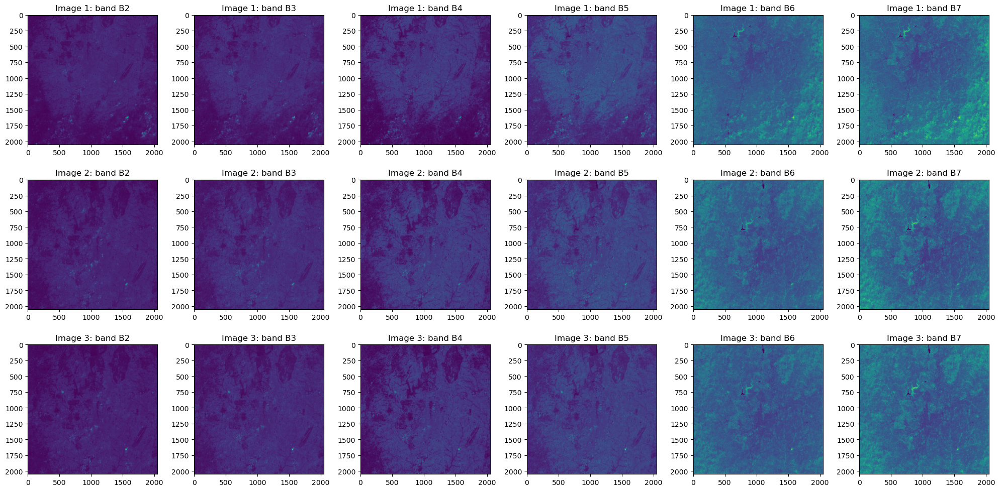

In [12]:
fig, ax = plt.subplots(len(tile_list), 6, figsize=(20, 10))

for i in range(len(tile_list)):
    for j in range(6):
        ax[i, j].imshow(img_stack[i, :, :, j])
        ax[i, j].set_title(f'Image {i+1}: band B{j+2}')

fig.tight_layout();


### Preprocess and plot the True Color Image (RGB)

In [14]:
### Process Geo-raster 
geo_data, geo_enhanced = s2u.geo_enhance_s2_rgb(img_stack)


In [15]:
print(geo_data.shape)
print(geo_enhanced.shape)


(3, 2048, 2048, 11)
(3, 2048, 2048, 11)


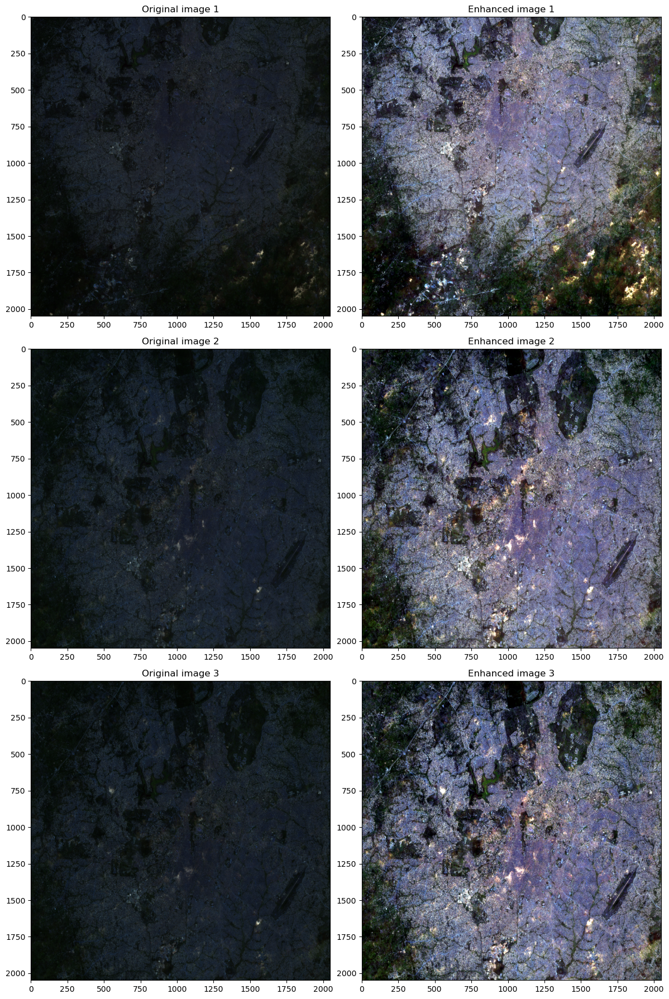

In [17]:
fig, ax = plt.subplots(3, 2, figsize=(12, 18))

for i in range(3):
    ax[i, 0].imshow(img_stack[i, :, :, :3])
    ax[i, 1].imshow(geo_enhanced[i, :, :, :3])
    ax[i, 0].set_title(f'Original image {i+1}')
    ax[i, 1].set_title(f'Enhanced image {i+1}')

fig.tight_layout();


## Advanced Sentinel-2A Images Preprocessing  

### Helper and custom functions

In [18]:
def read_sentinel_image(file_path):
    """
    Reads a Sentinel-2A image from a .tiff file using rasterio.

    Args:
        file_path (str): Path to the .tiff file.

    Returns:
        np.ndarray: Multispectral image data.
        rasterio.profiles.Profile: Metadata of the image.
    """
    with rio.open(file_path) as src:
        image_data = src.read()
        metadata = src.profile

    return image_data, metadata

def resize_image(image, target_height, target_width):
    """
    Resizes the image to the specified width and height.

    Args:
        image (np.ndarray): Multispectral image data.
        target_height (int): Target height for resizing.
        target_width (int): Target width for resizing.

    Returns:
        np.ndarray: Resized image data.
    """
    # Reshape the image to (height, width, channels) format
    image_reshaped = reshape_as_image(image)
    resized_image = cv2.resize(image_reshaped, (target_width, target_height), interpolation=cv2.INTER_LINEAR)
    
    # Reshape back to (bands, height, width) format
    resized_image = np.transpose(resized_image, (2, 0, 1))

    return resized_image

def create_patches(image, patch_size):
    """
    Splits the image into smaller patches.

    Args:
        image (np.ndarray): Resized image data.
        patch_size (int): Size of each patch (patch_size x patch_size).

    Returns:
        List[np.ndarray]: List of image patches.
    """
    patches = []
    bands, height, width = image.shape
    for i in range(0, height, patch_size):
        for j in range(0, width, patch_size):
            patch = image[:, i:i + patch_size, j:j + patch_size]
            if patch.shape[1] == patch_size and patch.shape[2] == patch_size:
                patches.append(patch)
    return patches

def save_image(image, file_path, metadata):
    """
    Saves the image to a .tiff file.

    Args:
        image (np.ndarray): Image data to save.
        file_path (str): Path to save the .tiff file.
        metadata (rasterio.profiles.Profile): Metadata for the image.
    """
    metadata.update({
        'height': image.shape[1],
        'width': image.shape[2],
        'count': image.shape[0]
    })
    with rio.open(file_path, 'w', **metadata) as dst:
        dst.write(image)

def save_patches(patches, output_dir, metadata):
    """
    Saves the image patches to the specified directory.

    Args:
        patches (List[np.ndarray]): List of image patches to save.
        output_dir (str): Directory to save the patches.
        metadata (rasterio.profiles.Profile): Metadata for the patches.
    """
    check_create_dir(output_dir) # Check if directory exists create 
    
    for idx, patch in enumerate(patches):
        patch_file_path = os.path.join(output_dir, f'patch_{idx}.tif')
        save_image(patch, patch_file_path, metadata)


In [19]:
def enhance_image(image_data):
    """
    Enhance the quality of the image by stretching or shrinking its intensity levels.

    Args:
        image (np.ndarray): Resized image data.

    Returns:
        np.ndarray: Enhanced image data.
    """
    # Change the axis from (band, x, y) to (x, y, band)
    image_data = np.transpose(image_data, (1, 2, 0))

    # Data preprocessing: enhancing the image quality
    data_enhanced = np.zeros(image_data.shape)
    for i in range(data.shape[-1]):
        p2, p98 = np.percentile(image_data[:, :, i], (2, 98))
        data_enhanced[:, :, i] = exposure.rescale_intensity(image_data[:, :, i], in_range=(p2, p98))

    # Reshape back to (bands, height, width) format
    data_enhanced = np.transpose(data_enhanced, (2, 0, 1))
    
    return data_enhanced


### Usage Examples


#### Example 1

In [24]:
### Set some global parameters: pathes, files, and image size
file_path = os.path.join(image_dir, tile_list[1])
target_height, target_width = 2048, 2048
patch_size = 256
#
patch_dir = os.path.join(proc_data_dir, "Ibadan/S2/patches")
enhanced_patch_dir = os.path.join(proc_data_dir, "Ibadan/S2/enhanced_patches")
check_create_dir(patch_dir)
check_create_dir(enhanced_patch_dir)
#
resized_output_file = os.path.join(proc_data_dir, f"Ibadan/S2", f"{tile_list[1].split('.')[0]}_resized_{target_height}x{target_width}.tif")
enhanced_output_file = os.path.join(proc_data_dir, f"Ibadan/S2", f"{tile_list[1].split('.')[0]}_enhanced_{target_height}x{target_width}.tif")
print(resized_output_file)
print(enhanced_output_file)


The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/patches' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/enhanced_patches' already exists
/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/S2_Ibadan_2022-09-01_2022-12-31_file1_resized_2048x2048.tif
/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/S2_Ibadan_2022-09-01_2022-12-31_file1_enhanced_2048x2048.tif


In [28]:
### Step 1: Read the Sentinel-2A image
image_data, metadata = read_sentinel_image(file_path)

### Step 2: Resize the image
resized_image = resize_image(image_data, target_height, target_width)

### Step 3: Enhance the image
enhanced_image_data = enhance_image(resized_image)

### Step 4: Save the resized image
save_image(resized_image, resized_output_file, metadata)
save_image(resized_image, enhanced_output_file, metadata)

### Step 5: Create patches
patches = create_patches(resized_image, patch_size)
enhanced_patches = create_patches(enhanced_image_data, patch_size)

### Step 6: Save the patches as individual .tiff files
save_patches(patches, patch_dir, metadata)
save_patches(patches, enhanced_patch_dir, metadata)




The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/patches' already exists
The folder '/Users/ldjeutsch/PYTHON-DATA-SCI/UMP/outputs/processed-data/Ibadan/S2/enhanced_patches' already exists


## Some visualizations

### Helper functions

In [25]:

def plot_bands(image_data, patch_id=None):
    """
    Plots all the bands of the raster image.
    
    Args:
        image_data (np.ndarray): Multispectral image data.
        patch_id (str, optional): Patch number. Defaults to None.
    """
    num_bands = image_data.shape[0]
    
    fig, axes = plt.subplots(1, num_bands, figsize=(20, 5))
    if num_bands == 1:
        axes = [axes]
    
    for i in range(num_bands):
        ax = axes[i]
        ax.imshow(image_data[i])
        if patch_id is not None:
            ax.set_title(f'{patch_id}: Band {i+2}')
        else:
            ax.set_title(f'Band {i+2}')
        ax.axis('off')
    
    plt.show()

def plot_rgb(image_data, rgb_indices=(3, 2, 1), ax=None):
    """
    Plots the RGB true color image.

    Args:
        image_data (np.ndarray): Multispectral image data.
        rgb_indices (tuple, optional): Indices of the bands to use for RGB. Defaults to (3, 2, 1) for Sentinel-2A.
        ax (Axis, optional): Axis on which the image is shown. Defaults to None.

    Raises:
        ValueError: RGB indices must be a tuple of three band indices.
    """
    if len(rgb_indices) != 3:
        raise ValueError("RGB indices must be a tuple of three band indices.")
    
    rgb_image = np.dstack([image_data[rgb_indices[0]-1], image_data[rgb_indices[1]-1], image_data[rgb_indices[2]-1]])
    rgb_image = (rgb_image - rgb_image.min()) / (rgb_image.max() - rgb_image.min())
    
    if ax is not None:
        ax.imshow(rgb_image, cmap="terrain")
    else:
        plt.figure(figsize=(10, 10))
        plt.imshow(rgb_image, cmap="terrain")
        plt.title('RGB True Color Image')
        plt.axis('off')
        plt.show()


### Example usage 1: show the original image as a whole

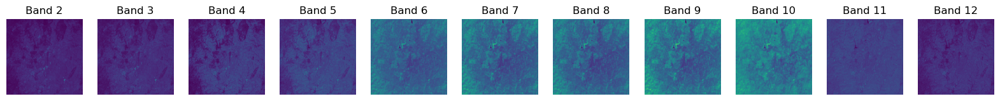

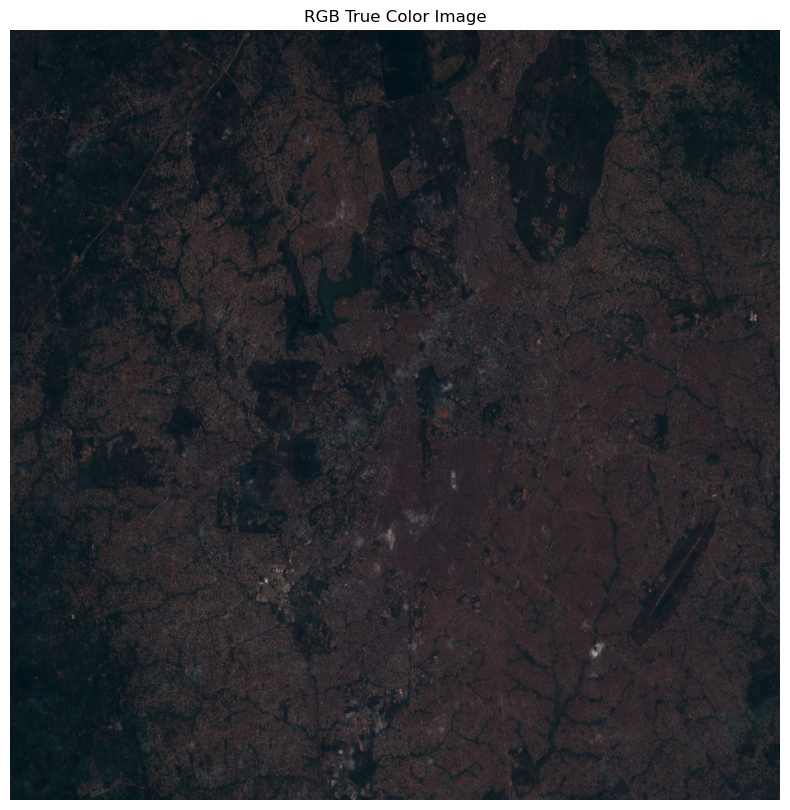

In [26]:
# Example usage
file_path = resized_output_file
# file_path = file_path

# Step 1: Open the raster image
image_data, metadata = read_sentinel_image(file_path)

# Step 2: Plot all the bands
plot_bands(image_data)

# Step 3: Plot the RGB true color image
# Note: Modify the rgb_indices based on the specific bands in your dataset
plot_rgb(image_data, rgb_indices=(3, 2, 1))


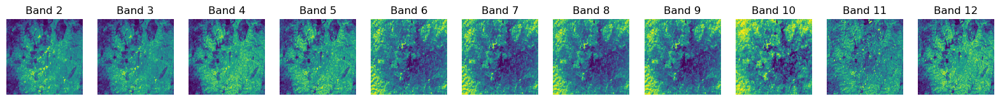

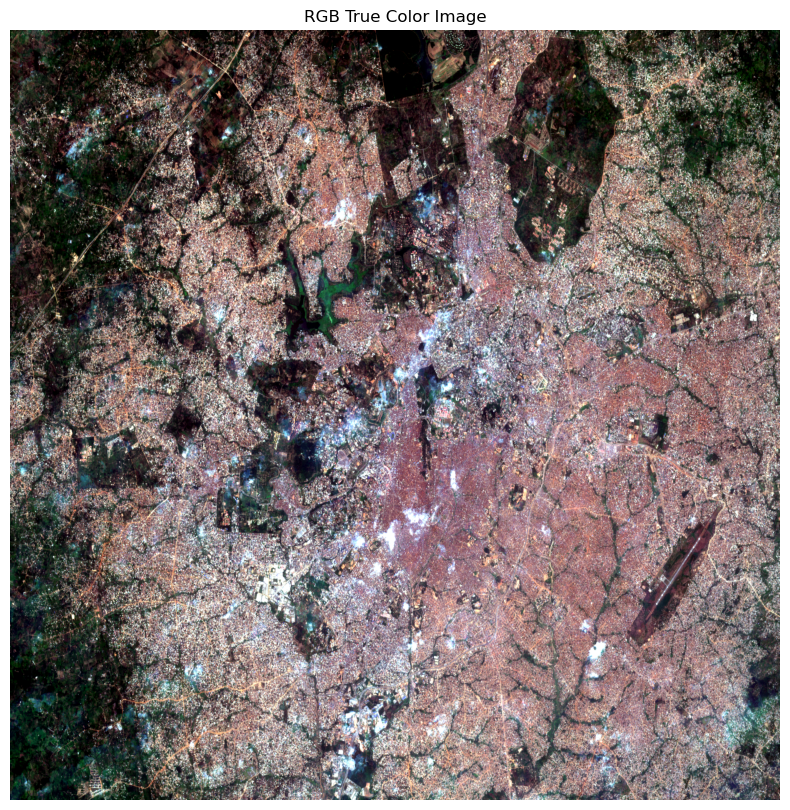

In [29]:
### Enhanced image: plot all the bands
plot_bands(enhanced_image_data)

### Enhanced image: plot the RGB true color image
# Note: Modify the rgb_indices based on the specific bands in your dataset
plot_rgb(enhanced_image_data, rgb_indices=(3, 2, 1))


### Example 2: show patches or tiles of the original image

#### Tile bands level

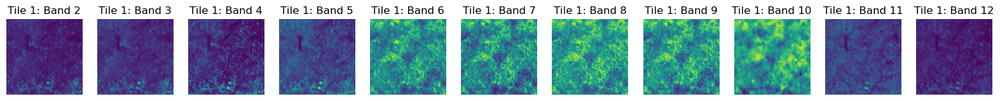

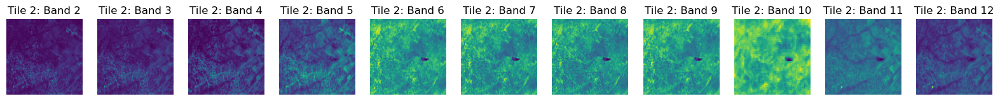

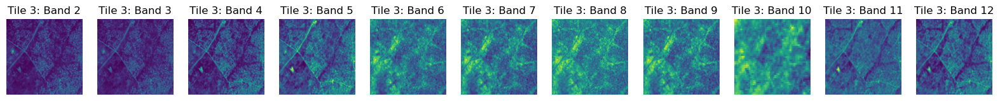

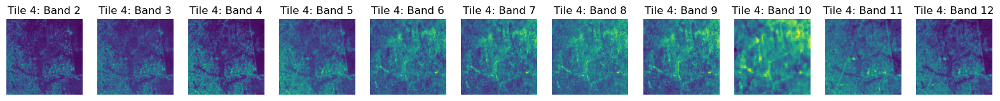

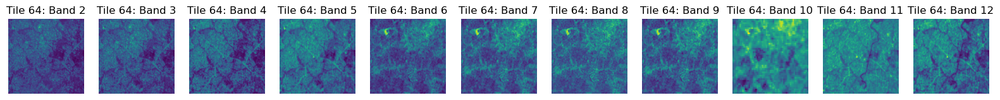

In [30]:
### Original image: plot all the bands
plot_bands(patches[0], patch_id="Tile 1")
plot_bands(patches[1], patch_id="Tile 2")
plot_bands(patches[2], patch_id="Tile 3")
plot_bands(patches[3], patch_id="Tile 4")
plot_bands(patches[-1], patch_id=f"Tile {len(patches)}")


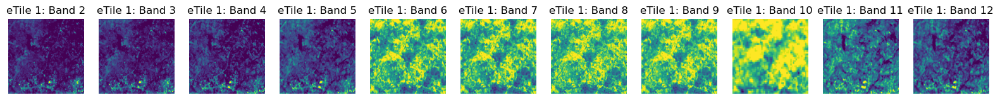

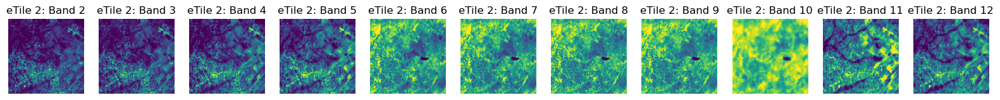

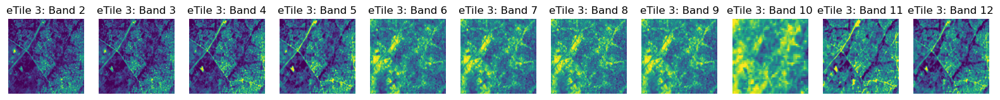

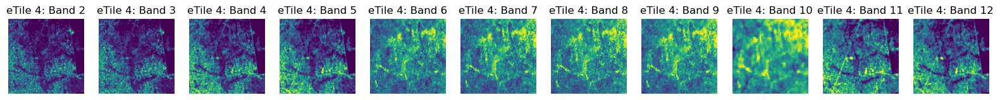

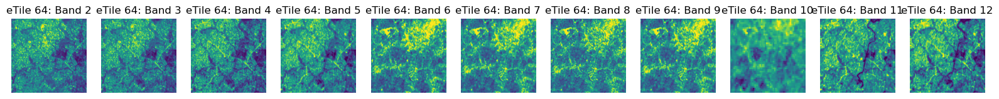

In [31]:
### Enhanced image: plot all the bands
plot_bands(enhanced_patches[0], patch_id="eTile 1")
plot_bands(enhanced_patches[1], patch_id="eTile 2")
plot_bands(enhanced_patches[2], patch_id="eTile 3")
plot_bands(enhanced_patches[3], patch_id="eTile 4")
plot_bands(enhanced_patches[-1], patch_id=f"eTile {len(patches)}")


#### Show the true RBG image at the tiles/patches level

In [33]:
from glob import glob


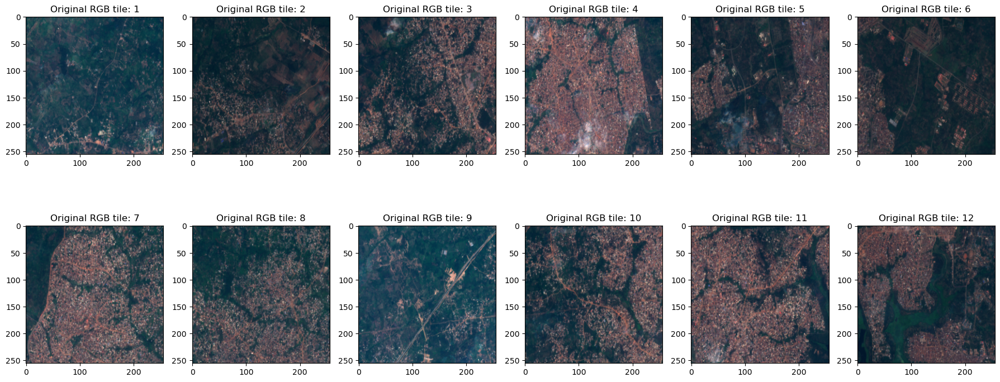

In [34]:
### Original image true RGB patches
tiff_list = sorted(glob(f"{patch_dir}/*"))

# Open and read the raster image
raster_imgs = []
for path in tiff_list[:(2*6)]:
    raster_img = read_sentinel_image(path)
    raster_imgs.append(raster_img)

# Plot the RGB true color image
fig, axes = plt.subplots(2, 6, figsize=(18, 8))
axes = axes.reshape(-1)
for i in range(len(axes)):
    plot_rgb(raster_imgs[i][0], rgb_indices=(3, 2, 1), ax=axes[i])
    axes[i].set_title(f"Original RGB tile: {i+1}")

fig.tight_layout();


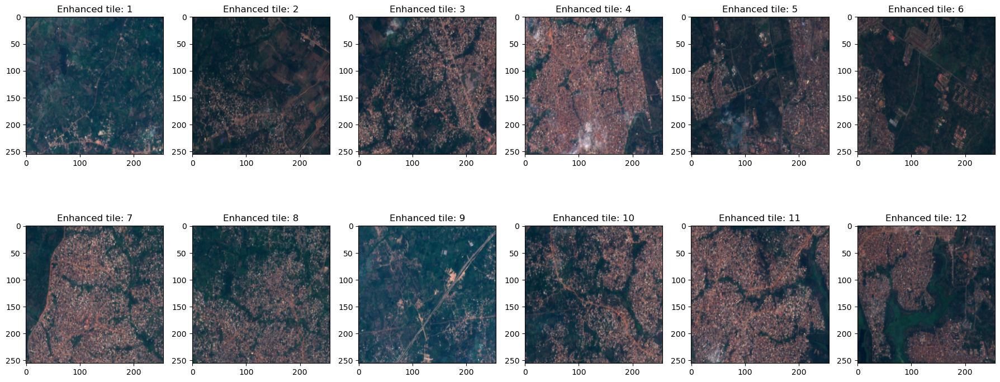

In [35]:
### Enhanced image true RGB patches
tiff_list = sorted(glob(f"{enhanced_patch_dir}/*"))

# Open and read the raster image
raster_imgs = []
for path in tiff_list[:(2*6)]:
    raster_img = read_sentinel_image(path)
    raster_imgs.append(raster_img)

# Plot the RGB true color image
fig, axes = plt.subplots(2, 6, figsize=(18, 8))
axes = axes.reshape(-1)
for i in range(len(axes)):
    plot_rgb(raster_imgs[i][0], rgb_indices=(3, 2, 1), ax=axes[i])
    axes[i].set_title(f"Enhanced tile: {i+1}")

fig.tight_layout();


## Spectral Indix Preprocessing

### Helper functions

In [313]:
class CalculateSpectralIndices():
    def __init__(self, subdata) -> None:
        self.subdata = subdata
    
    def ndvi(self):
        return (self.subdata["B8"] - self.subdata["B4"]) / (self.subdata["B8"] + self.subdata["B4"])


    def ndbi(self):
        return (self.subdata["B11"] - self.subdata["B9"]) / (self.subdata["B11"] + self.subdata["B9"])


    def savi(self):
        return 1.5 * (self.subdata["B9"] - self.subdata["B4"]) / (self.subdata["B9"] + self.subdata["B4"] + 0.5)


    def mndwi(self):
        return (self.subdata["B3"] - self.subdata["B11"]) / (self.subdata["B3"] + self.subdata["B11"])


    def ui(self):
        return (self.subdata["B7"] - self.subdata["B5"]) / (self.subdata["B7"] + self.subdata["B5"])


    def nbi(self):
        return self.subdata["B4"] * self.subdata["B11"] / self.subdata["B9"]


    def brba(self):
        return self.subdata["B4"] / self.subdata["B11"]


    def nbai(self):
        return (self.subdata["B11"] - self.subdata["B12"] / self.subdata["B3"]) / (self.subdata["B11"] + self.subdata["B12"] / self.subdata["B3"])


    def mbi(self):
        return (self.subdata["B12"] * self.subdata["B4"] - self.subdata["B9"] ** 2) / (self.subdata["B4"] + self.subdata["B9"] + self.subdata["B12"])


    def baei(self):
        return (self.subdata["B4"] + 0.3) / (self.subdata["B3"] + self.subdata["B11"])


    def ibi(self):
        """
        Calculates the index-based building index (IBI).
        Source: https://stats.stackexchange.com/questions/178626/how-to-normalize-data-between-1-and-1

        Args:
            area_dict (dict or pd.DataFrame) : A Python dictionary or Python DataFrame containing
                                            the 11 band values

        Returns:


        """

        # Threshold
        t = 0.05

        # Normalize to (-1,1)
        ndbi_t, savi_t, mndwi_t = self.ndbi(), self.savi(), self.mndwi()
        ndbi_n = 2 * (ndbi_t - ndbi_t.min()) / (ndbi_t.max() - ndbi_t.min()) - 1
        savi_n = 2 * (savi_t - savi_t.min()) / (savi_t.max() - savi_t.min()) - 1
        mndwi_n = (
            2 * (mndwi_t - mndwi_t.min()) / (mndwi_t.max() - mndwi_t.min()) - 1
        )

        # Remove outliers
        temp = (ndbi_n - (savi_n + mndwi_n) / 2) / (ndbi_n + (savi_n + mndwi_n) / 2)
        vv = pd.DataFrame({"col": temp.reshape(-1, 1)[:, 0]})
        cutoffs = list(vv["col"].quantile([t / 2, 1 - t / 2]))

        temp[temp <= cutoffs[0]] = cutoffs[0]
        temp[temp >= cutoffs[1]] = cutoffs[1]

        return temp


def read_bands_make_indices(image_list, aoi):
    """
    Reads the bands for each image of the area of interest (AOI) and calculates
    the derived spectral indices.

    Args:
        image_list (list): Python list containing the image file paths
        of the AOI.f interest.

    Returns:
        data (pd.DataFrame): The resulting pandas dataframe containing the raw spectral
                              bands and derived indices
    """

    bands = ['B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12']
    data = []
    # Iterate over each year
    for image_file in image_list:
        
        # Read each band
        subdata = dict()
        raster = rio.open(image_file)
        
        for band_idx, band in enumerate(bands):
            band_data = raster.read(band_idx + 1).ravel()
            subdata[band] = band_data

        # Get derived indices
        spectral_indices = CalculateSpectralIndices(subdata)
        subdata["ndvi"] = spectral_indices.ndvi()
        subdata["ndbi"] = spectral_indices.ndbi()
        subdata["savi"] = spectral_indices.savi()
        subdata["mndwi"] = spectral_indices.mndwi()
        subdata["ui"] = spectral_indices.ui()
        subdata["nbi"] = spectral_indices.nbi()
        subdata["brba"] = spectral_indices.brba()
        subdata["nbai"] = spectral_indices.nbai()
        subdata["mbi"] = spectral_indices.mbi()
        subdata["baei"] = spectral_indices.baei()

        # Cast to pandas subdataframe
        subdata = pd.DataFrame(subdata).fillna(0)
        subdata.columns = [column + "_" + str(aoi) for column in subdata.columns]

        data.append(subdata)
        del subdata

    data = pd.concat(data, axis=1)

    return data



def make_windows(image_file, grid_blocks=5):
    """Make a list of windows based on bounds of an image file"""

    windows = []
    subdata = dict()
    raster = rio.open(image_file)
    src_shape = raster.shape
    height, width = int(src_shape[0] / grid_blocks), int(
        src_shape[1] / grid_blocks
    )
    grid_indices = list(
        itertools.product(range(grid_blocks), range(grid_blocks))
    )
    grid_cnt = len(grid_indices)

    # Read each window
    for idx in range(len(grid_indices)):
        i, j = grid_indices[idx]
        row_start, row_stop, col_start, col_stop = (
            i * height,
            (i + 1) * height,
            j * width,
            (j + 1) * width,
        )
        w = Window.from_slices((row_start, row_stop), (col_start, col_stop))
        windows.append(w)

    return windows

def write_indices(image_list, aoi, indices_dir, tmp_dir):
    """
    Reads the bands for each image of each area and calculates the derived indices.

    Args:
        area_dict (dict) : Python dictionary containing the file paths per area
        area (str) : The area of interest (AOI)

    Returns:
        data (pd.DataFrame) : The resulting pandas dataframe containing the raw spectral
                              bands and derived indices
    """

    image_array = {}
    bands = ['B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12']
    
    p = Path(tmp_dir)
    tmp_files = [str(f) for f in list(p.glob("tmp*.tif"))]
    for f in tmp_files:
        os.remove(f)

    import math

    def get_grid_blocks(filepath):
        # prevent memory inflation by making sure each block processes max 50mb only
        mb_size = os.path.getsize(filepath) / 1024 / 1024
        return math.ceil(math.sqrt(mb_size / 50))

    # Iterate over each file
    for image_file in tqdm(image_list, total=len(image_list)):
        output_file = indices_dir + "indices_" + aoi + ".tif"

        image = rio.open(image_file)
        grid_blocks = get_grid_blocks(image_file)
        windows = make_windows(image_file, grid_blocks=grid_blocks)

        image_meta = image.meta
        indices_meta = image_meta.copy()
        indices_meta.update(
            {
                "driver": "GTiff",
                "count": 10,
                "nodata": -1,
                "dtype": np.float64,
            }
        )

        for idx, window in tqdm(enumerate(windows), total=len(windows)):

            window_size = {
                "height": window.height,
                "width": window.width,
                "transform": transform(window, transform=image.transform),
            }
            indices_meta.update(window_size)

            for band_idx, band in enumerate(bands):
                band_window = image.read(band_idx+1, window=window)
                band_values = band_window.ravel()
                image_array[f"{band}"] = band_values

            # Get derived indices
            spectral_indices = CalculateSpectralIndices(image_array)
            image_array["ndvi"] = spectral_indices.ndvi()
            image_array["ndbi"] = spectral_indices.ndbi()
            image_array["savi"] = spectral_indices.savi()
            image_array["mndwi"] = spectral_indices.mndwi()
            image_array["ui"] = spectral_indices.ui()
            image_array["nbi"] = spectral_indices.nbi()
            image_array["brba"] = spectral_indices.brba()
            image_array["nbai"] = spectral_indices.nbai()
            image_array["mbi"] = spectral_indices.mbi()
            image_array["baei"] = spectral_indices.baei()

            for index in image_array:
                image_array[index] = (
                    image_array[index]
                    .reshape((window.height, window.width))
                    .astype(np.float64)
                )

            # save index window to tiff
            tmp_file = tmp_dir + f"tmp{idx}.tif"
            with rio.open(
                tmp_file, "w", **indices_meta, compress="deflate"
            ) as dst:
                dst.write(image_array["ndvi"], 1)
                dst.write(image_array["ndbi"], 2)
                dst.write(image_array["savi"], 3)
                dst.write(image_array["mndwi"], 4)
                dst.write(image_array["ui"], 5)
                dst.write(image_array["nbi"], 6)
                dst.write(image_array["brba"], 7)
                dst.write(image_array["nbai"], 8)
                dst.write(image_array["mbi"], 9)
                dst.write(image_array["baei"], 10)

        # collect to windows to 1 tif
        stitch(output_file, tmp_dir)

    return area_dict


In [303]:
image_list = [resized_output_file]
aoi = "Ibadan"
s2df_train_data = read_bands_make_indices(image_list, aoi)


In [304]:
s2df_train_data


,B2_Ibadan,B3_Ibadan,B4_Ibadan,B5_Ibadan,B6_Ibadan,B7_Ibadan,B8_Ibadan,B8A_Ibadan,B9_Ibadan,B11_Ibadan,...,ndvi_Ibadan,ndbi_Ibadan,savi_Ibadan,mndwi_Ibadan,ui_Ibadan,nbi_Ibadan,brba_Ibadan,nbai_Ibadan,mbi_Ibadan,baei_Ibadan
0,0.208264,0.199423,0.171012,0.204991,0.376449,0.439621,0.408066,0.474842,0.154700,0.305378,...,0.409365,0.327505,-0.029632,-0.209896,0.363986,0.337577,0.560000,-0.525560,0.018322,0.933065
1,0.208038,0.198966,0.172388,0.206100,0.368850,0.432350,0.408738,0.470200,0.154700,0.309650,...,0.406709,0.333692,-0.032080,-0.217619,0.354374,0.345056,0.556720,-0.521960,0.018886,0.928773
2,0.209839,0.201806,0.172112,0.209759,0.367645,0.424408,0.410991,0.454272,0.154700,0.310141,...,0.409668,0.334396,-0.031589,-0.211613,0.338475,0.345049,0.554949,-0.519271,0.019275,0.922190
3,0.209751,0.203480,0.175961,0.209278,0.362702,0.419026,0.397415,0.448299,0.154463,0.312194,...,0.386228,0.338002,-0.038832,-0.210819,0.333832,0.355644,0.563627,-0.516016,0.021070,0.922987
4,0.209441,0.200593,0.173456,0.206500,0.348250,0.405700,0.386153,0.436100,0.153750,0.318200,...,0.380083,0.348448,-0.035733,-0.226693,0.325384,0.358982,0.545115,-0.519685,0.021525,0.912609
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4194299,0.221941,0.212091,0.201453,0.226750,0.295750,0.334800,0.319845,0.362500,0.142400,0.339900,...,0.227110,0.409496,-0.104970,-0.231541,0.192414,0.480856,0.592683,-0.553678,0.050902,0.908443
4194300,0.218034,0.208824,0.192091,0.217339,0.289927,0.330149,0.308524,0.355432,0.142400,0.324739,...,0.232579,0.390332,-0.089320,-0.217246,0.206051,0.438059,0.591525,-0.546381,0.042656,0.922273
4194301,0.217889,0.208399,0.191058,0.213900,0.287800,0.328450,0.307258,0.352850,0.142400,0.319200,...,0.233185,0.383016,-0.087571,-0.210010,0.211210,0.428270,0.598552,-0.541979,0.040383,0.930741
4194302,0.218940,0.206948,0.189809,0.211368,0.291726,0.337324,0.310826,0.364302,0.142400,0.310233,...,0.241727,0.370793,-0.085451,-0.199707,0.229557,0.413518,0.611826,-0.539231,0.037373,0.947074


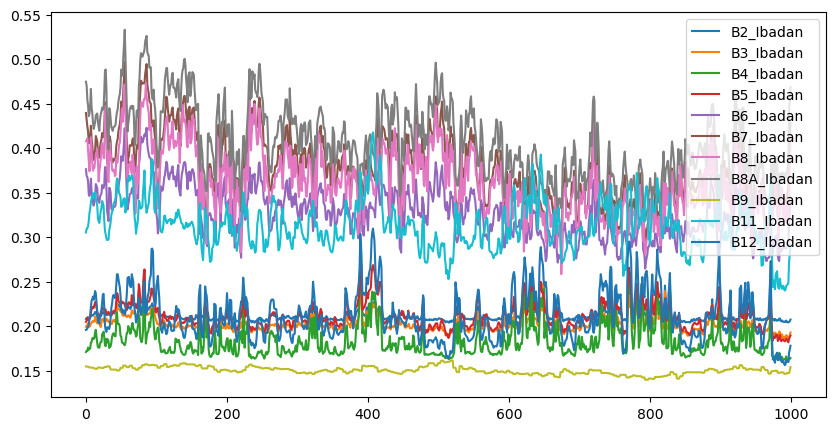

In [310]:
s2df_train_data.iloc[:1000,:11].plot(figsize=(10, 5));


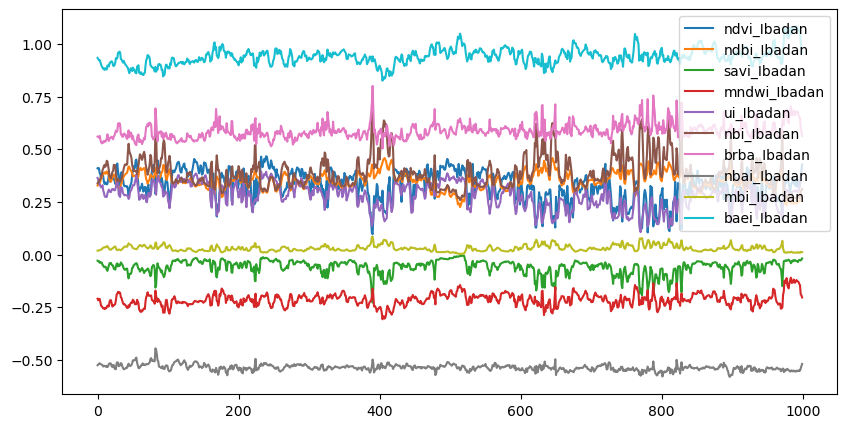

In [309]:
s2df_train_data.iloc[:1000,11:].plot(figsize=(10, 5));
